### categorical variable to color scatterplot
(3-dimension)

In [ ]:
def scatterplot_cat(cat):
    plt.figure()
    sns.lmplot( x="sepal_length", y="sepal_width", data=df, fit_reg=False, hue='species', legend=False)
    #x,y are continuous, hue is categorical variales

### totoal_price VS 

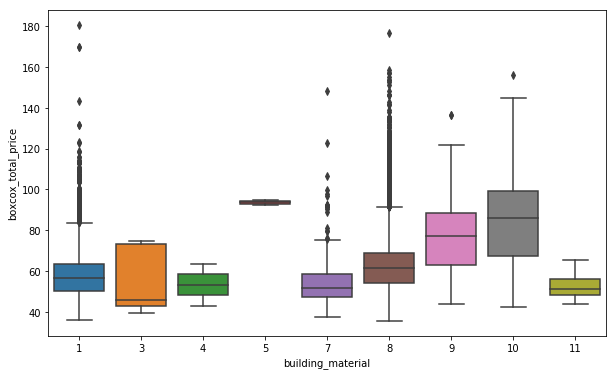

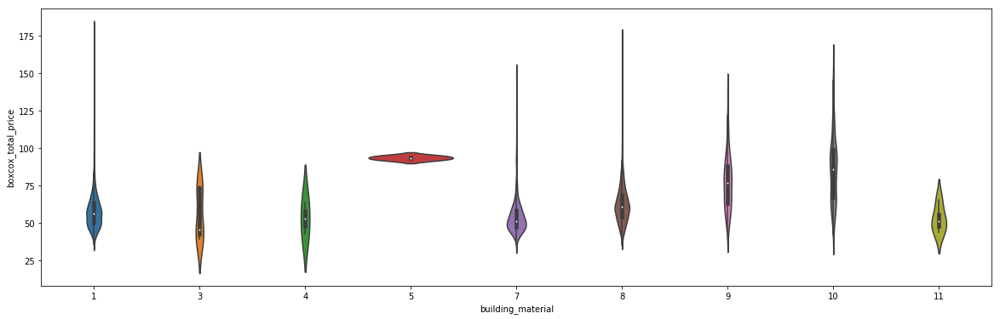

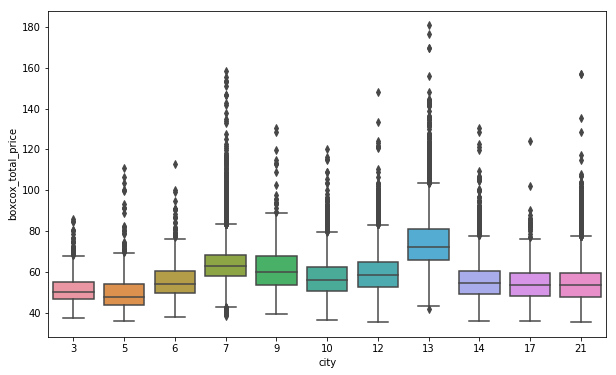

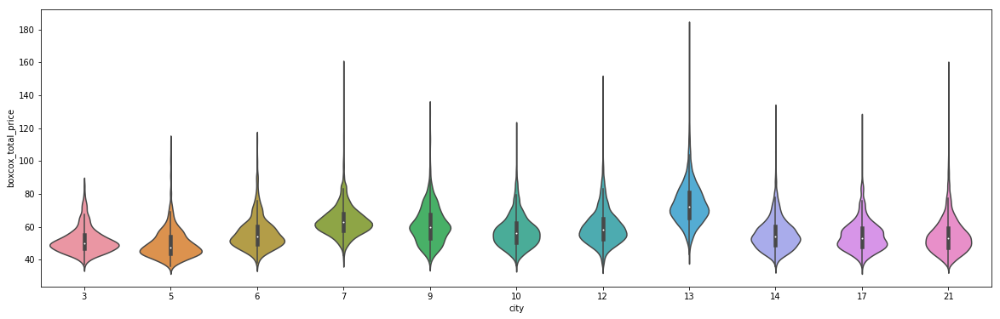

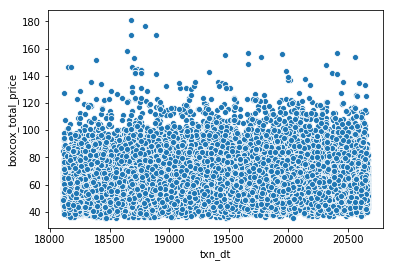

...

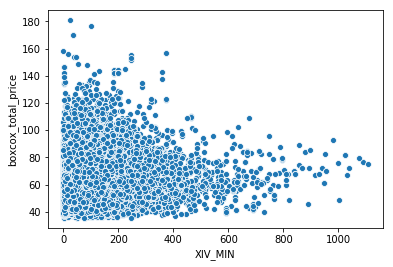

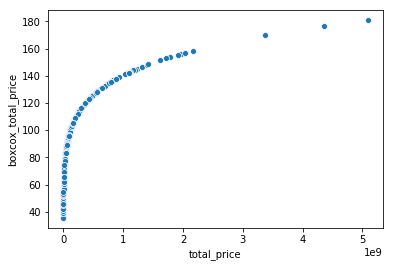

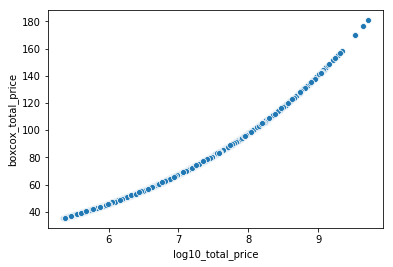

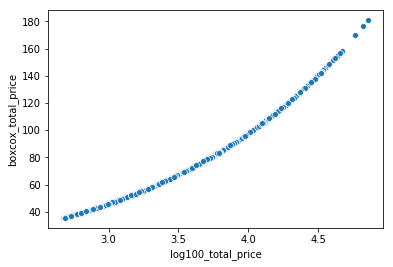

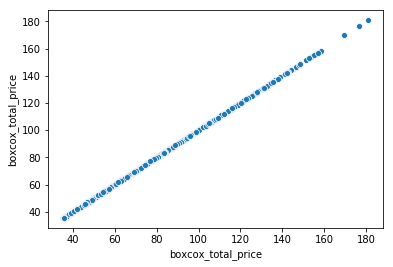

In [11]:
dtype_select = [pd.np.dtype('float64'), pd.np.dtype('int64')]
numeric_columns = list(data_train.columns[list(data_train.dtypes.isin(dtype_select))])

for col in numeric_columns:
    cat = data_train[col].drop_duplicates()
    
    #boxplot by group
    def boxplot(cat):
        binSeq = cat.sort_values().tolist() #排序
        plt.figure(num=None, figsize=(10, 6))
        sns.boxplot(x=data_train[col], y=data_train["boxcox_total_price"])
    #violin plot
    def violinplot(cat):
        plt.figure(num=None, figsize=(20, 6))
        sns.violinplot(x=data_train[col], y=data_train["boxcox_total_price"])
    #scatterplot
    def scatterplot(cat):
        plt.figure()
        sns.scatterplot(x=data_train[col], y=data_train["boxcox_total_price"])

    if(cat.size < 30):
        boxplot(cat)
        violinplot(cat)    
    elif(cat.size > 29):    
        scatterplot(cat)
      

### total_price

In [5]:
def describe(series, bin):
    #偏度, 峯度
    print("skewness", stats.skew(series), "\nkurtosis", stats.kurtosis(series)) 
    #描述性統計&百分位數
    print(pd.to_numeric(series).describe([.01, 0.25, 0.50, 0.75, 0.99]))
    #長條圖
    plt.figure()
    series.hist(bins=bin)
    #長條圖計數
    counts, bins = np.histogram(series)
    print(series.value_counts(bins=bin))
    #機率圖
    plt.figure(num=None, figsize=(8, 8), dpi=60, facecolor='w', edgecolor='k')
    sns.distplot(series, bins=bin)
    
def transform(series):
    data_train['log10_total_price'] = np.log10(data_train['total_price'])
    data_train['log100_total_price'] = (np.log(data_train['total_price'])/np.log(100))
    data_train['boxcox_total_price'] = stats.boxcox(data_train['total_price'], lmbda=0.14897829)
                                                    
def boxcox(series):
    lmbda = stats.boxcox(data_train['total_price'])
    print(lmbda)
        
def normality(series):
    #QQ-Plot
    plt.figure()
    stats.probplot(series, plot=plt) 
    #PPCC-dPlot
    plt.figure()
    stats.ppcc_plot(series,-4,4,dist=stats.norm,plot=plt)
    #box-plot
    plt.figure()
    sns.boxplot(series)

    
    
# describe(data_train['total_price'], 10) #極右偏, Weibull distr.
# normality(data_train['total_price'])
transform(data_train['total_price'])

#log10(Y)
# describe(data_train['log10_total_price'], 10)
# normality(data_train['log10_total_price'])

#boxcox
# boxcox(data_train['total_price']) #lmbda=0.14897829
# describe(data_train['boxcox_total_price'], 100)
# normality(data_train['boxcox_total_price']) 



### 檢視所有變數(Pair Plot)

In [ ]:
plt.figure()   
sns.pairplot(data_train, kind="scatter")

### 檢視所有變數

In [52]:
# 篩選數值型的欄位
dtype_select = [pd.np.dtype('float64'),pd.np.dtype('int64')]
numeric_columns = list(data_train.columns[list(data_train.dtypes.isin(dtype_select))])


# 檢視數值範圍
for col in numeric_columns:
    #data_train[[col]].boxplot()
    #print(data_train[col].drop_duplicates()) #去重複值
    cat = data_train[col].drop_duplicates()
    #檢視資料值
    print(col, ', ', cat.size)
    print(data_train[col].value_counts())

    def histogram(cat):
        if (cat.size > 0):
            binSeq = cat.sort_values().tolist() #排序
            plt.figure(num=None, figsize=(20, 10), dpi=60)
            #長條圖
            data_train[[col]].hist(bins=cat.sort_values().tolist())
            #boxplot by group
            sns.boxplot(x=data_train[col], y=data_train["total_price"])
      
    #histogram(cat)

building_material ,  9
8     52609
1      6372
10      462
7       375
9       167
3         7
11        4
5         2
4         2
Name: building_material, dtype: int64
city ,  11
7     19664
13    10756
21     7964
12     7264
14     4704
10     4676
5      1224
9      1125
17      984
6       826
3       813
Name: city, dtype: int64
txn_dt ,  1782
18921    75
19285    74
20311    62
20090    61
20420    61
20557    60
20371    60
20073    59
20409    59
19593    58
19759    58
20313    58
19872    58
19775    57
20502    57
20312    57
20060    57
19135    57
19866    57
20376    56
19857    56
20067    56
19786    55
20480    55
20377    55
20501    55
18712    55
20558    55
19852    54
19828    54
20375    54
19712    54
20621    54
20094    54
20622    54
20103    54
20577    53
19776    53
20559    53
20507    53
20258    53
19192    53
20481    53
20077    53
19139    53
20228    53
20305    52
20374    52
20257    52
19747    52
20279    52
20095    52
20364    52
19342    52


180    2604
13     2274
10     2059
158    1797
164    1630
17     1459
208    1428
39     1372
188    1366
101    1306
204    1300
6      1271
330    1146
284    1130
34     1119
84     1094
196    1010
290    1006
174     990
148     960
50      921
91      910
61      892
53      879
179     836
62      828
206     823
52      818
214     797
15      733
136     727
18      714
184     650
4       640
253     628
282     613
273     582
343     578
49      565
119     548
194     548
130     493
66      485
112     484
346     467
41      461
285     460
113     439
128     426
96      425
115     418
142     392
289     382
121     378
254     374
193     372
139     369
211     367
296     363
25      359
29      334
102     326
224     235
19      225
26      225
332     219
122     215
163     210
210     207
32      197
344     197
132     194
185     189
322     185
249     174
329     165
227     164
108     154
345     154
199     149
323     148
42      146
218     145
225 

1    59120
0      880
Name: I_index_1000, dtype: int64
I_5000 ,  853
99     285
90     285
43     282
42     281
88     263
64     257
98     254
156    246
87     241
91     233
144    228
136    226
83     225
81     222
63     221
44     221
155    220
86     220
72     219
82     217
151    216
85     212
143    211
84     208
89     208
100    206
68     204
141    203
119    203
146    202
142    199
101    197
65     196
96     192
145    192
80     190
57     190
150    188
70     188
97     186
129    186
140    186
95     183
73     182
130    182
158    182
56     181
154    180
78     180
138    179
93     177
69     176
62     174
45     174
137    173
79     173
58     173
120    171
128    169
66     167
67     166
139    166
126    166
74     165
46     165
49     164
94     162
71     162
116    162
157    159
134    158
149    158
147    158
153    156
115    156
50     155
55     153
108    153
105    152
148    149
112    149
118    147
152    147
77     147
47     

0     27617
1      9385
2      6874
3      4632
4      3189
5      2383
6      1748
7      1307
8       866
9       641
10      397
11      315
12      177
14      148
13      127
15       70
16       49
17       22
18       15
19       14
20        8
21        6
22        5
25        4
27        1
Name: III_100, dtype: int64
III_250 ,  74
0     9025
1     4267
2     3644
3     3228
4     2877
5     2692
6     2291
8     2219
9     2178
7     2124
11    1834
10    1824
12    1536
13    1485
14    1383
17    1321
15    1247
16    1237
18    1129
19    1097
20    1064
21     952
22     862
23     837
25     773
24     752
26     659
27     615
28     532
29     477
31     445
30     426
33     320
32     276
35     274
34     268
36     220
37     195
38     168
39     165
40     142
42     123
41     108
43     103
46      85
44      83
47      66
45      65
48      54
50      29
57      27
49      27
51      26
53      22
52      19
56      17
59      15
54      12
55       9
60       

0    49021
1    10979
Name: V_index_50, dtype: int64
V_100 ,  27
0     31535
1     12839
2      6309
3      3335
4      1926
5      1237
6       844
7       648
8       477
9       258
10      180
11      145
12      105
13       54
14       42
15       17
16       15
17       10
19        7
18        6
22        3
26        2
25        2
20        1
21        1
23        1
27        1
Name: V_100, dtype: int64
V_250 ,  72
0     8130
1     6920
2     6229
3     5285
4     4763
5     3960
6     3175
7     2848
8     2346
9     2186
10    1739
11    1435
12    1390
13    1110
14     830
15     807
16     798
17     721
18     615
19     470
20     458
21     400
22     373
24     371
23     344
25     305
26     235
27     186
28     184
32     159
29     154
30     138
31     122
33     113
34     106
35      84
36      54
38      49
40      48
37      47
44      41
41      39
42      34
39      28
43      23
47      23
45      19
46      18
48      12
50      11
68      10
49       8
8

0      3074
2      2453
1      2411
3      2262
4      2156
6      2007
5      1964
7      1940
9      1810
8      1774
10     1676
11     1628
12     1516
14     1471
13     1385
16     1336
17     1266
15     1253
18     1252
19     1154
20     1059
21     1020
22      990
24      926
23      900
25      832
26      807
29      795
28      765
27      698
30      681
31      637
32      617
33      607
34      604
36      482
38      452
39      450
40      417
35      413
43      392
37      389
42      388
41      365
44      320
46      277
48      274
51      272
45      261
50      257
47      241
54      237
53      230
49      221
59      221
52      218
57      210
56      204
58      181
55      170
64      161
60      154
63      142
62      141
61      135
65      124
67      115
68      107
69      103
70      102
72      102
73       95
85       95
75       93
78       90
66       88
74       79
76       78
90       77
71       71
82       70
77       70
84       70
79  

91.229902      36
28.734171      36
20.946726      29
81.692048      25
66.494130      20
40.724767      20
36.169048      18
31.467864      14
38.199006      14
42.118571      14
123.806598     13
41.038430      13
0.350970       13
80.686610      13
90.862931      13
28.497456      12
685.762857     12
61.065389      12
57.083256      12
94.099687      12
0.561164       12
36.632243      12
58.566686      12
39.752602      12
21.831694      12
47.305513      11
1.279652       11
34.182845      11
51.939891      11
39.265429      11
14.803457      11
48.452341      11
55.138090      11
11.951100      11
1873.963801    11
18.857397      11
194.043504     10
113.192296     10
10.305114      10
224.652923     10
49.042011      10
0.264371       10
0.091386       10
17.700286      10
2.675317       10
0.445219       10
56.120060      10
36.586488      10
112.909699     10
2.510475        9
88.905209       9
0.324325        9
66.994081       9
15.847437       9
176.204531      9
162.318182

0    53779
1     6221
Name: XI_index_50, dtype: int64
XI_100 ,  9
0    39850
1     9361
2     7606
3     2206
4      726
5      170
6       44
7       22
8       15
Name: XI_100, dtype: int64
XI_250 ,  22
0     13652
1      6895
4      6085
2      5967
5      5543
3      5249
6      4634
7      3845
8      2783
9      2079
10     1251
11      823
12      527
13      337
14      150
15       88
16       39
17       27
18       14
19        7
21        4
30        1
Name: XI_250, dtype: int64
XI_500 ,  61
0     5967
2     2903
1     2745
3     2224
4     2168
9     2087
16    1931
19    1927
17    1895
18    1877
20    1855
15    1845
8     1824
22    1758
21    1755
10    1751
13    1714
14    1699
11    1696
12    1622
23    1576
7     1522
6     1495
5     1445
24    1424
25    1397
26    1111
27     961
28     837
29     776
30     631
31     616
32     504
33     464
34     415
35     400
36     256
38     157
37     146
41     108
39     100
42      89
40      83
43      64
44     

0     56346
1      2463
2       719
3       138
4        49
6        48
8        37
5        32
7        30
13       21
9        19
10       12
11       12
12        9
22        9
15        8
14        6
17        6
28        5
18        4
32        4
29        4
16        3
19        3
21        3
33        3
20        2
23        2
25        2
24        1
Name: XIII_50, dtype: int64
XIII_index_50 ,  2
0    56346
1     3654
Name: XIII_index_50, dtype: int64
XIII_100 ,  48
0     50093
1      5819
2      2376
3       635
4       273
5       108
8        80
6        65
7        63
11       50
13       39
9        36
12       36
10       32
23       25
16       24
14       23
17       22
15       22
18       20
24       18
20       16
19       13
30       12
21       11
34       10
37        8
22        8
36        8
35        7
29        6
38        5
31        5
26        5
91        5
28        4
39        3
32        3
27        2
33        2
73        1
42        1
76        1
50    

299.642318    36
257.673357    36
301.817882    29
100.629844    25
75.403548     20
28.563491     20
265.111587    18
128.892890    14
88.902819     14
98.039670     14
59.352815     13
239.871244    13
275.645750    13
110.522644    13
52.533450     13
116.402631    12
27.168588     12
55.404690     12
23.589869     12
251.849025    12
172.327317    12
290.021762    12
41.527008     12
120.749171    12
134.518296    12
58.250712     11
41.872207     11
232.141873    11
2.602707      11
128.160298    11
88.630889     11
95.470739     11
92.049608     11
55.720796     11
83.496026     11
63.094204     11
7.246433      10
33.808460     10
48.336973     10
142.034964    10
79.184294     10
123.840722    10
199.761625    10
70.755310     10
49.711594     10
2.483123      10
97.070083     10
280.062052    10
79.743996     10
256.329493     9
97.051944      9
187.211877     9
43.154024      9
589.751915     9
14.223954      9
72.544727      9
41.261764      9
136.267156     9
141.529657    


### 顯示資料

In [36]:
#顯示欄位
data_train.columns.tolist()
print('-'*80)

#顯示空值
print(data_train.isnull().sum())
print('-'*80)

#顯示型態
print(data_train.dtypes)
print('-'*80)
data_train #60000 rows × 235 columns

--------------------------------------------------------------------------------
building_id                    0
building_material              0
city                           0
txn_dt                         0
total_floor                    0
building_type                  0
building_use                   0
building_complete_dt           0
parking_way                    0
parking_area               56897
parking_price              46065
txn_floor                  15902
land_area                      0
building_area                  0
town                           0
lat                            0
lon                            0
village_income_median       1142
town_population                0
town_area                      0
town_population_density        0
doc_Rate                       0
master_rate                    0
bachelor_rate                  0
jobschool_rate                 0
highschool_rate                0
junior_rate                    0
elementary_rate             

,building_id,building_material,city,txn_dt,total_floor,building_type,building_use,building_complete_dt,parking_way,parking_area,parking_price,txn_floor,land_area,building_area,town,lat,lon,village_income_median,town_population,town_area,town_population_density,doc_Rate,master_rate,bachelor_rate,jobschool_rate,highschool_rate,junior_rate,elementary_rate,born_rate,death_date,marriage_rate,divorce_rate,village,N_50,N_500,N_1000,N_5000,N_10000,I_10,I_50,I_index_50,I_100,I_250,I_500,I_index_500,I_1000,I_index_1000,I_5000,I_index_5000,I_10000,I_index_10000,I_MIN,II_10,II_50,II_index_50,II_100,II_250,II_500,II_index_500,II_1000,II_index_1000,II_5000,II_index_5000,II_10000,II_index_10000,II_MIN,III_10,III_50,III_index_50,III_100,III_250,III_500,III_index_500,III_1000,III_index_1000,III_5000,III_index_5000,III_10000,III_index_10000,III_MIN,IV_10,IV_50,IV_index_50,IV_100,IV_250,IV_500,IV_index_500,IV_1000,IV_index_1000,IV_5000,IV_index_5000,IV_10000,IV_index_10000,IV_MIN,V_10,V_50,V_index_50,V_100,V_250,V_500,V_index_500,V_1000,V_index_1000,V_5000,V_index_5000,V_10000,V_index_10000,V_MIN,VI_10,VI_50,VI_index_50,VI_100,VI_250,VI_500,VI_index_500,VI_1000,VI_index_1000,VI_5000,VI_index_5000,VI_10000,VI_index_10000,VI_MIN,VII_10,VII_50,VII_index_50,VII_100,VII_250,VII_500,VII_index_500,VII_1000,VII_index_1000,VII_5000,VII_index_5000,VII_10000,VII_index_10000,VII_MIN,VIII_10,VIII_50,VIII_index_50,VIII_100,VIII_250,VIII_500,VIII_index_500,VIII_1000,VIII_index_1000,VIII_5000,VIII_index_5000,VIII_10000,VIII_index_10000,VIII_MIN,IX_10,IX_50,IX_index_50,IX_100,IX_250,IX_500,IX_index_500,IX_1000,IX_index_1000,IX_5000,IX_index_5000,IX_10000,IX_index_10000,IX_MIN,X_10,X_50,X_index_50,X_100,X_250,X_500,X_index_500,X_1000,X_index_1000,X_5000,X_index_5000,X_10000,X_index_10000,X_MIN,XI_10,XI_50,XI_index_50,XI_100,XI_250,XI_500,XI_index_500,XI_1000,XI_index_1000,XI_5000,XI_index_5000,XI_10000,XI_index_10000,XI_MIN,XII_10,XII_50,XII_index_50,XII_100,XII_250,XII_500,XII_index_500,XII_1000,XII_index_1000,XII_5000,XII_index_5000,XII_10000,XII_index_10000,XII_MIN,XIII_10,XIII_50,XIII_index_50,XIII_100,XIII_250,XIII_500,XIII_index_500,XIII_1000,XIII_index_1000,XIII_5000,XIII_index_5000,XIII_10000,XIII_index_10000,XIII_MIN,XIV_10,XIV_50,XIV_index_50,XIV_100,XIV_250,XIV_500,XIV_index_500,XIV_1000,XIV_index_1000,XIV_5000,XIV_index_5000,XIV_10000,XIV_index_10000,XIV_MIN,total_price
0,e3mMIMR3JJqCaXz1,8,21,18674,4,3,2,6271,2,NaN,NaN,3.0,18.144460,3.418175,334,-39.14,117.08,572.0,24219.0,1.4161,17103.0,0.003948,0.047944,0.208219,0.102360,0.327584,0.166931,0.143015,7.37,7.72,5.74,2.39,3132,2,14,14,14,14,0,0,0,1,5,20,1,59,1,399,1,779,1,84.745794,0,0,0,0,4,9,1,37,1,805,1,1992,1,102.554396,0,1,1,3,17,37,1,91,1,1861,1,3728,1,42.635964,0,0,0,0,0,7,1,18,1,224,1,299,1,287.735804,0,0,0,0,2,23,1,56,1,1077,1,2001,1,205.295496,0,0,0,0,0,5,1,17,1,97,1,201,1,270.838262,0,0,0,0,17,93,1,277,1,4028,1,6989,1,116.075571,0,0,0,1,15,85,1,160,1,3432,1,6607,1,69.868801,0,0,0,1,5,40,1,79,1,1110,1,1944,1,68.178741,0,0,0,2,3,16,1,43,1,807,1,1620,1,64.774668,0,0,0,0,6,18,1,56,1,853,1,1886,1,132.498164,0,0,0,5,25,91,1,203,1,4342,1,9448,1,63.478618,0,0,0,0,1,2,1,8,1,147,1,295,1,112.582703,0,1,1,3,21,58,1,157,1,2483,1,6011,1,34.469803,6.476038e+05
1,LgwzgklNvy4QCtq5,8,7,18800,5,1,2,7885,2,NaN,NaN,5.0,11.387227,4.041309,180,-37.66,119.28,550.0,551480.0,23.1373,23835.0,0.003518,0.048779,0.216042,0.106792,0.310975,0.195193,0.118700,7.94,5.93,6.11,2.50,921,5,12,14,14,14,0,0,0,1,2,5,1,13,1,487,1,1334,1,85.529684,0,0,0,3,8,18,1,41,1,1691,1,4304,1,71.994648,1,1,1,1,4,11,1,29,1,2512,1,7380,1,7.157464,0,0,0,0,0,0,0,7,1,94,1,492,1,805.037288,0,0,0,1,7,11,1,26,1,1799,1,5331,1,65.829031,0,0,0,0,0,0,0,5,1,77,1,354,1,719.071571,1,1,1,3,18,31,1,94,1,5050,1,18608,1,6.864786,0,0,0,2,9,16,1,76,1,5204,1,15064,1,65.829031,0,0,0,0,5,7,1,17,1,1349,1,4399,1,102.299486,0,0,0,0,0,4,1,25,1,1084,1,3004,1,272.553558,0,0,0,0,6,11,1,24,1,949,1,3053,1,125.670173,0,3,1,14,45,81,1,285,1,9846,1,25456,1,23.717447,0,1,1,2,4,5,1,1

### 匯入資料

In [2]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
pd.set_option('display.max_columns', 500) #設定顯示最大欄數
pd.set_option('display.max_rows', 1000) #設定顯示最大列數
from scipy import stats



#input data
dir_data = "/Users/Hanna/Desktop/_Python/realEstateValution_ESB/dataset/"
data_train = pd.read_csv(dir_data + 'train.csv')
data_test = pd.read_csv(dir_data + 'test.csv')